In [1]:
!pip install -q eclipse-sumo gymnasium pettingzoo sumo-rl stable-baselines3 torch matplotlib tqdm supersuit

# Imports & Configuración global

In [ ]:
import os
import sys
import random
import numpy as np
import torch

# Verificar SUMO_HOME
if "SUMO_HOME" not in os.environ:
    default_sumo_path = "sumo-git/usr/share/sumo"
    print(f"[INFO] SUMO_HOME no definido; usando ruta por defecto: {default_sumo_path}")
    os.environ["SUMO_HOME"] = default_sumo_path

# Añadir sumo/tools al PYTHONPATH
tools_path = os.path.join(os.environ["SUMO_HOME"], "tools")
if tools_path not in sys.path:
    sys.path.append(tools_path)

# Imports específicos de RL y simulación

# Reproducibilidad
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)

# Hiperparámetros globales
MAX_EPISODE_STEPS = 1000      # límites de pasos por episodio
N_EPISODES_EVAL   = 100       # episodios para evaluación final
TRAIN_STEPS       = 300_000   # timesteps totales de entrenamiento rápido
N_AGENTS          = 4         # número de carriles/vehículos concurrentes (placeholder)
print("[INFO] Imports y configuración completados correctamente.")

[INFO] SUMO_HOME no definido; usando ruta por defecto: sumo-git/usr/share/sumo
[INFO] Imports y configuración completados correctamente.


In [3]:
!pip install -qr $SUMO_HOME/tools/requirements.txt

# Generación de la intersección y rutas
- Creamos un cruce 4-vías con netgenerate
- Generamos rutas aleatorias con randomTrips.py
- Deja todo en la carpeta sumo_env

In [4]:
!rm sumo_env/*

import os, subprocess, shutil, sys

WORK_DIR = "sumo_env"
os.makedirs(WORK_DIR, exist_ok=True)

NET_FILE   = os.path.abspath(os.path.join(WORK_DIR, "intersection.net.xml"))
ROUTE_FILE = os.path.abspath(os.path.join(WORK_DIR, "routes.rou.xml"))

# 2.1 Generar la red si no existe
if not os.path.exists(NET_FILE):
    print("[INFO] Generando red con netgenerate …")
    cmd_net = [
        "netgenerate",
        "--grid",
        "--grid.number=2",        # 2×2 celdas → 3×3 nodos, con un cruce central
        "--default.speed=13.9",   # 50 km/h
        "--default.lanenumber=1",
        "--turn-lanes.length=25",
        "--tls.guess",              # activa inferencia de semáforos
        "--tls.guess.threshold", "0",   # ← fuerza TLS en cada cruce
        "--output-file", NET_FILE,
    ]
    subprocess.run(cmd_net, check=True)
else:
    print("[INFO] Archivo de red ya existe, se omite generación.")

# 2.2 Generar rutas aleatorias si no existen
if not os.path.exists(ROUTE_FILE):
    print("[INFO] Generando rutas con randomTrips.py …")
    random_trips = os.path.join(os.environ["SUMO_HOME"], "tools", "randomTrips.py")
    cmd_rt = [
        sys.executable, random_trips,
        "-n", NET_FILE,
        "-r", ROUTE_FILE,
        "-e", "1000",          # duración simulación (s)
        "--seed", str(SEED),
        "--prefix", "veh",
        "--period", "1"        # ~1 vehículo/s
    ]
    subprocess.run(cmd_rt, check=True)
else:
    print("[INFO] Archivo de rutas ya existe, se omite generación.")

print(f"[OK] Net file:   {NET_FILE}")
print(f"[OK] Route file: {ROUTE_FILE}")

[INFO] Generando red con netgenerate …
Success.
[INFO] Generando rutas con randomTrips.py …
Success.
[OK] Net file:   /home/aldo/Documents/UNAM/Posgrado/2025-II/RL/Proyecto/sumo_env/intersection.net.xml
[OK] Route file: /home/aldo/Documents/UNAM/Posgrado/2025-II/RL/Proyecto/sumo_env/routes.rou.xml


# 3. Wrapper `sumo-rl` → PettingZoo
- Definimos un entorno multiagente basado en SUMO y PettingZoo ParallelEnv.
- Cada “agente” controlará la aceleración de un vehículo ficticio en uno de los N carriles de entrada.
- Hay placeholders marcados con TODO para que completes la lógica de extracción de observaciones y aplicación de acciones usando Traci (o la API de sumo-rl).

In [ ]:
from pettingzoo.utils.env import ParallelEnv
from gymnasium import spaces
from sumo_rl import SumoEnvironment
import numpy as np
import traci

MAX_SPEED = 13.9  # m/s (~50 km/h)

class IntersectionEnv(ParallelEnv):
    metadata = {"render.modes": ["human"], "name": "intersection_v0"}

    def __init__(self,
                 net_file: str,
                 route_file: str,
                 n_agents: int = N_AGENTS,
                 max_steps: int = MAX_EPISODE_STEPS):
        super().__init__()
        self.render_mode = None
        self.net_file     = net_file
        self.route_file   = route_file
        self.n_agents     = n_agents
        self.max_steps    = max_steps

        # Crear entorno SUMO
        self.env = SumoEnvironment(
            net_file=self.net_file,
            route_file=self.route_file,
            use_gui=False,
            num_seconds=self.max_steps
        )

        # Definimos agentes y mapeo a vehículos
        self.agents = [f"agent_{i}" for i in range(self.n_agents)]
        self.possible_agents = self.agents.copy()
        self.agent_veh = {}

        # Espacios de acción y observación
        self.action_spaces = {a: spaces.Discrete(3) for a in self.agents}
        obs_dim = 2  # [velocidad, gap al líder]
        self.observation_spaces = {
            a: spaces.Box(0.0, np.inf, shape=(obs_dim,), dtype=float)
            for a in self.agents
        }
        self.steps = 0

    def reset(self, seed=None, options=None):
        self.steps = 0
        _ = self.env.reset()

        # Esperar hasta que haya n_agents vehículos disponibles
        max_wait_steps = 10 * self.n_agents
        waited = 0
        while len(traci.vehicle.getIDList()) < self.n_agents and waited < max_wait_steps:
            # avanzamos un paso de simulación
            _ = self.env.step(action=None)
            waited += 1

        veh_ids = traci.vehicle.getIDList()
        if len(veh_ids) < self.n_agents:
            raise RuntimeError(f"Solo se encontraron {len(veh_ids)} vehículos, pero se requieren {self.n_agents}")

        # Mapear los primeros n_agents vehículos
        for agent, veh in zip(self.agents, veh_ids[: self.n_agents]):
            self.agent_veh[agent] = veh

        # Construir observaciones iniciales
        obs = {}
        for agent, veh in self.agent_veh.items():
            speed = traci.vehicle.getSpeed(veh)
            leader = traci.vehicle.getLeader(veh)
            gap = leader[1] if leader is not None else MAX_SPEED
            obs[agent] = np.array([speed, gap], dtype=float)
        return obs, {}


    def step(self, actions):
        """
        Acepta tanto dict {agent: action} como array vectorizado de SB3.
        """
        #print(f"[DEBUG step] tipo(actions)={type(actions)}, acciones={actions}")
        if not isinstance(actions, dict):
            arr = np.array(actions)
            print(f"[DEBUG] array shape de actions: {arr.shape}")
            # SB3 suele usar num_envs=1 en tu caso, así que tomamos env=0
            arr = arr[0] if arr.ndim > 1 else arr
            # mapeamos a {agent_i: int(action_i)}
            actions = {
                agent: int(arr[i])
                for i, agent in enumerate(self.agents)
            }
        # ————————————————————————————————

        self.steps += 1
        # Avanzar primer para poblar traci
        _ = self.env.step(action=None)

        veh_list = traci.vehicle.getIDList()
        obs, rewards, terminations, truncations = {}, {}, {}, {}

        # Aplicar acciones sólo a vehículos presentes
        for agent, act in actions.items():
            veh = self.agent_veh[agent]
            if veh in veh_list:
                curr_speed = traci.vehicle.getSpeed(veh)
                if act == 0:
                    target = curr_speed + 1.0
                elif act == 1:
                    target = curr_speed
                else:
                    target = max(curr_speed - 1.0, 0.0)
                traci.vehicle.setSpeed(veh, target)

        # Recopilar obs y recompensas
        for agent, veh in self.agent_veh.items():
            if veh in veh_list:
                speed = traci.vehicle.getSpeed(veh)
                leader = traci.vehicle.getLeader(veh)
                gap = leader[1] if leader is not None else MAX_SPEED
                obs[agent] = np.array([speed, gap], dtype=float)
                rewards[agent] = speed / MAX_SPEED
                done = False
            else:
                obs[agent] = np.array([0.0, MAX_SPEED], dtype=float)
                rewards[agent] = 0.0
                done = True

            terminations[agent] = done or (self.steps >= self.max_steps)
            truncations[agent] = False

        return obs, rewards, terminations, truncations, {}


    def render(self, mode="human"):
        pass

    def close(self):
        self.env.close()

# Prueba rápida
if __name__ == "__main__":
    env = IntersectionEnv(net_file=NET_FILE, route_file=ROUTE_FILE)
    obs, _ = env.reset()
    print("Obs iniciales:", obs)
    # Un paso de prueba
    sample_actions = {agent: env.action_spaces[agent].sample() for agent in env.agents}
    obs2, rew2, term2, trunc2, _ = env.step(sample_actions)
    print("Obs tras paso:", obs2)
    print("Rewards:", rew2)

 Retrying in 1 seconds
Step #0.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 0 ACT 0 BUF 0)                      
 Retrying in 1 seconds
Obs iniciales: {'agent_0': array([ 6.3543097, 13.9      ]), 'agent_1': array([ 5.02191843, 13.9       ]), 'agent_2': array([ 2.45550322, 13.9       ]), 'agent_3': array([ 0.        , 91.13550322])}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': np.int64(0), 'agent_1': np.int64(2), 'agent_2': np.int64(0), 'agent_3': np.int64(1)}
Obs tras paso: {'agent_0': array([13.35481736, 13.9       ]), 'agent_1': array([14.05593463, 13.9       ]), 'agent_2': array([12.70336119, 13.9       ]), 'agent_3': array([ 10.25149329, 101.38336119])}
Rewards: {'agent_0': 0.9607782270720161, 'agent_1': 1.0112183184497032, 'agent_2': 0.9139108768037834, 'agent_3': 0.7375175031103033}


In [6]:
import numpy as np

def baseline_policy(observations, gap_threshold=5.0):
    """
    observations: dict {agent: np.array([speed, gap])}
    gap_threshold: distancia mínima de seguridad para mantener/acelerar
    """
    actions = {}
    for agent, obs in observations.items():
        speed, gap = obs
        # 0=acelerar, 1=mantener, 2=frenar
        if gap > gap_threshold:
            actions[agent] = 0  # acelerar
        else:
            actions[agent] = 2  # frenar
    return actions

# Ejecutar episodios de baseline
n_episodes = 50
baseline_rewards = []

for ep in range(n_episodes):
    obs, _ = env.reset()
    ep_reward = 0.0
    for t in range(MAX_EPISODE_STEPS):
        acts = baseline_policy(obs)
        obs, rewards, terms, truns, _ = env.step(acts)
        # recompensas normalizadas entre 0 y 1
        ep_reward += np.mean(list(rewards.values()))
        if all(terms.values()):
            break
    baseline_rewards.append(ep_reward)

print(f"[RESULTADO] Baseline (media sobre {n_episodes} episodios): "
      f"{np.mean(baseline_rewards):.3f} ± {np.std(baseline_rewards):.3f}")

Step #10.00 (0ms ?*RT. ?UPS, TraCI: 6ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 0, 'agent_1': 0, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 0, 'agent_1': 0, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 0, 'agent_1': 0, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 0, 'agent_1': 0, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 0, 'agent_1': 0, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 0, 'agent_1': 0, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 0, 'agent_1': 0, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 0, 'agent_1': 0, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] 

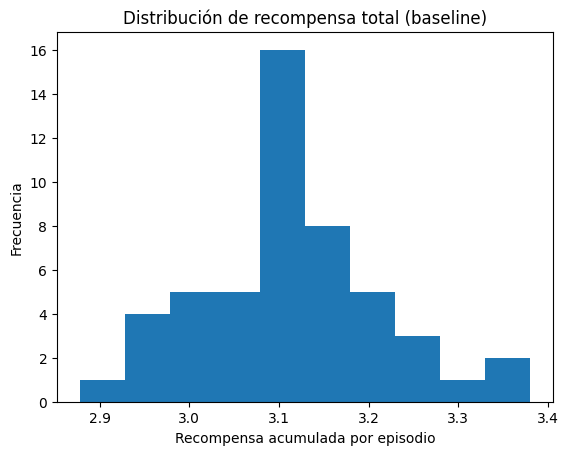

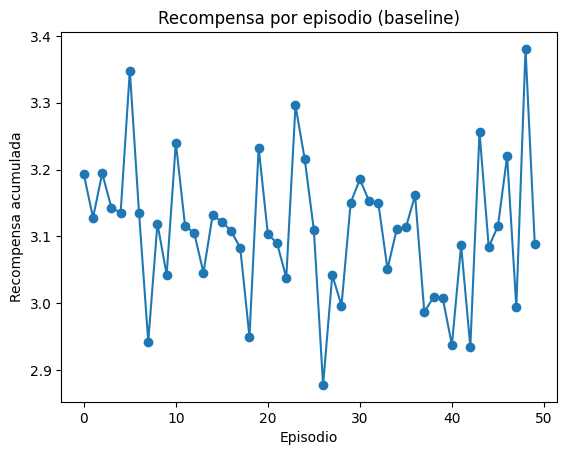

Baseline — media: 3.109, desviación: 0.103


In [7]:
import matplotlib.pyplot as plt

# Histograma de recompensas por episodio
plt.figure()
plt.hist(baseline_rewards, bins=10)
plt.title("Distribución de recompensa total (baseline)")
plt.xlabel("Recompensa acumulada por episodio")
plt.ylabel("Frecuencia")
plt.show()

# Curva de evolución (reward episodio vs. episodio)
plt.figure()
plt.plot(baseline_rewards, marker='o', linestyle='-')
plt.title("Recompensa por episodio (baseline)")
plt.xlabel("Episodio")
plt.ylabel("Recompensa acumulada")
plt.show()

# Estadísticos resumen
mean_br = np.mean(baseline_rewards)
std_br  = np.std(baseline_rewards)
print(f"Baseline — media: {mean_br:.3f}, desviación: {std_br:.3f}")


# Entrenamiento MAPPO (política compartida vía PPO)

In [21]:
from gymnasium import Env, spaces
import numpy as np

class SingleAgentIntersectionEnv(Env):
    def __init__(self, net_file, route_file, n_agents=N_AGENTS, **kwargs):
        super().__init__()
        self.multi_env = IntersectionEnv(
            net_file=net_file,
            route_file=route_file,
            n_agents=n_agents,
            **kwargs
        )
        self.n_agents = n_agents
        # Espacio de acción: un entero por agente (0,1,2)
        self.action_space = spaces.MultiDiscrete([3] * self.n_agents)
        # Espacio de observación: [vel, gap] × n_agents
        obs_dim = self.n_agents * self.multi_env.observation_spaces[self.multi_env.agents[0]].shape[0]
        self.observation_space = spaces.Box(0.0, np.inf, shape=(obs_dim,), dtype=float)

    def reset(self, seed=None, options=None):
        obs_dict, _ = self.multi_env.reset(seed=seed, options=options)
        self.done = False
        return self._dict_to_array(obs_dict), {}

    def step(self, action):
        # Desempaquetar acción MultiDiscrete a dict para ParallelEnv
        act_dict = {
            f"agent_{i}": int(action[i])
            for i in range(self.n_agents)
        }
        obs_dict, rewards, terms, truncs, info = self.multi_env.step(act_dict)
        # Observación vectorizada
        obs = self._dict_to_array(obs_dict)
        # Recompensa agregada
        reward = float(np.mean(list(rewards.values())))
        # Episodio terminado si TODOS los agentes terminan
        self.done = all(terms.values())
        return obs, reward, self.done, False, info

    def _dict_to_array(self, obs_dict):
        # Concatena en orden agent_0, agent_1, …
        return np.concatenate([obs_dict[f"agent_{i}"] for i in range(self.n_agents)], axis=0)

    def render(self, mode="human"):
        # opcional: podríamos llamar a self.multi_env.render()
        pass

    def close(self):
        self.multi_env.close()

In [ ]:
from stable_baselines3 import PPO
from stable_baselines3.common.vec_env import DummyVecEnv

# 1) Creamos la función de fábrica para DummyVecEnv
def make_env():
    return SingleAgentIntersectionEnv(
        net_file=NET_FILE,
        route_file=ROUTE_FILE,
        n_agents=N_AGENTS,
        max_steps=MAX_EPISODE_STEPS
    )

# 2) DummyVecEnv con 4 entornos en paralelo
vec_env = DummyVecEnv([make_env for _ in range(4)])

# 3) Definimos y entrenamos el modelo
model = PPO(
    "MlpPolicy",
    vec_env,
    verbose=1,
    tensorboard_log="./tb_singleagent",
    n_steps=256,
    batch_size=1024,
    learning_rate=3e-4,
    gamma=0.95,
)
TOTAL_STEPS = 200_000
model.learn(total_timesteps=TOTAL_STEPS)
model.save("singleagent_intersection")

print("[OK] Entrenamiento completado y modelo guardado.")


 Retrying in 1 seconds
Step #0.00 (0ms ?*RT. ?UPS, TraCI: 0ms, vehicles TOT 0 ACT 0 BUF 0)                      
 Retrying in 1 seconds
Step #0.00 (0ms ?*RT. ?UPS, TraCI: 0ms, vehicles TOT 0 ACT 0 BUF 0)                      
 Retrying in 1 seconds
Step #0.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 0 ACT 0 BUF 0)                      
 Retrying in 1 seconds
Step #0.00 (0ms ?*RT. ?UPS, TraCI: 0ms, vehicles TOT 0 ACT 0 BUF 0)                      
Using cuda device


/home/aldo/Documents/UNAM/Posgrado/2025-II/RL/Proyecto/.venv/lib/python3.12/site-packages/stable_baselines3/common/on_policy_algorithm.py:150: UserWarning: You are trying to run PPO on the GPU, but it is primarily intended to run on the CPU when not using a CNN policy (you are using ActorCriticPolicy which should be a MlpPolicy). See https://github.com/DLR-RM/stable-baselines3/issues/1245 for more info. You can pass `device='cpu'` or `export CUDA_VISIBLE_DEVICES=` to force using the CPU.Note: The model will train, but the GPU utilization will be poor and the training might take longer than on CPU.
  warnings.warn(


 Retrying in 1 seconds
 Retrying in 1 seconds
 Retrying in 1 seconds
 Retrying in 1 seconds
Logging to ./tb_singleagent/PPO_1
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 0, 'agent_1': 0, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 2, 'agent_1': 1, 'agent_2': 1, 'agent_3': 2}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 0, 'agent_1': 0, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 2, 'agent_1': 0, 'agent_2': 0, 'agent_3': 1}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 2, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 2, 'agent_2': 2, 'agent_3': 1}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 2, 'agent_2': 0, 'agent_3': 1}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 2, 'agent_1': 1, 'agent_2': 0, 'agent_3': 2}
[D

In [28]:
from tqdm.auto import trange
import numpy as np

# Recreamos el entorno single-agent (idéntico al de entrenamiento)
eval_env = DummyVecEnv([make_env])

N_EVAL_EP = 100
returns_mappo = []

for _ in trange(N_EVAL_EP, desc="Evaluando"):
    obs = eval_env.reset()
    done = [False]            # VecEnv devuelve lista/array
    ep_ret = 0.0
    while not done[0]:
        action, _ = model.predict(obs, deterministic=True)
        obs, reward, done, _ = eval_env.step(action)
        ep_ret += reward[0]   # reward también es array
    returns_mappo.append(ep_ret)

print(f"[MAPPO] media = {np.mean(returns_mappo):.3f}  ± {np.std(returns_mappo):.3f}")
print(f"[BASE ] media = {np.mean(baseline_rewards):.3f} ± {np.std(baseline_rewards):.3f}")

 Retrying in 1 seconds
Step #0.00 (0ms ?*RT. ?UPS, TraCI: 0ms, vehicles TOT 0 ACT 0 BUF 0)                      
Step #5.00 (0ms ?*RT. ?UPS, TraCI: 83410ms, vehicles TOT 4 ACT 4 BUF 0)                   


Evaluando:   0%|          | 0/100 [00:00<?, ?it/s]

 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3':

Evaluando:   1%|          | 1/100 [00:02<03:22,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:   2%|▏         | 2/100 [00:04<03:20,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:   3%|▎         | 3/100 [00:06<03:17,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:   4%|▍         | 4/100 [00:08<03:15,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:   5%|▌         | 5/100 [00:10<03:13,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:   6%|▌         | 6/100 [00:12<03:11,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:   7%|▋         | 7/100 [00:14<03:09,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:   8%|▊         | 8/100 [00:16<03:07,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:   9%|▉         | 9/100 [00:18<03:05,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  10%|█         | 10/100 [00:20<03:03,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  11%|█         | 11/100 [00:22<03:01,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  12%|█▏        | 12/100 [00:24<02:59,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  13%|█▎        | 13/100 [00:26<02:57,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  14%|█▍        | 14/100 [00:28<02:55,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  15%|█▌        | 15/100 [00:30<02:53,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  16%|█▌        | 16/100 [00:32<02:51,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  17%|█▋        | 17/100 [00:34<02:49,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  18%|█▊        | 18/100 [00:36<02:47,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  19%|█▉        | 19/100 [00:38<02:45,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 2ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  20%|██        | 20/100 [00:40<02:43,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  21%|██        | 21/100 [00:42<02:41,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  22%|██▏       | 22/100 [00:44<02:39,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  23%|██▎       | 23/100 [00:46<02:37,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  24%|██▍       | 24/100 [00:48<02:34,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  25%|██▌       | 25/100 [00:50<02:33,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  26%|██▌       | 26/100 [00:53<02:30,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  27%|██▋       | 27/100 [00:55<02:28,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  28%|██▊       | 28/100 [00:57<02:26,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  29%|██▉       | 29/100 [00:59<02:24,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  30%|███       | 30/100 [01:01<02:22,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  31%|███       | 31/100 [01:03<02:20,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  32%|███▏      | 32/100 [01:05<02:18,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  33%|███▎      | 33/100 [01:07<02:16,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  34%|███▍      | 34/100 [01:09<02:14,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  35%|███▌      | 35/100 [01:11<02:12,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  36%|███▌      | 36/100 [01:13<02:10,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  37%|███▋      | 37/100 [01:15<02:08,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  38%|███▊      | 38/100 [01:17<02:06,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  39%|███▉      | 39/100 [01:19<02:04,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  40%|████      | 40/100 [01:21<02:02,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  41%|████      | 41/100 [01:23<02:00,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  42%|████▏     | 42/100 [01:25<01:58,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 2ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  43%|████▎     | 43/100 [01:27<01:56,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  44%|████▍     | 44/100 [01:29<01:54,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  45%|████▌     | 45/100 [01:31<01:52,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  46%|████▌     | 46/100 [01:33<01:50,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  47%|████▋     | 47/100 [01:35<01:48,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  48%|████▊     | 48/100 [01:37<01:46,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  49%|████▉     | 49/100 [01:39<01:43,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  50%|█████     | 50/100 [01:41<01:41,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  51%|█████     | 51/100 [01:43<01:39,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  52%|█████▏    | 52/100 [01:46<01:37,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 0ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  53%|█████▎    | 53/100 [01:48<01:35,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  54%|█████▍    | 54/100 [01:50<01:33,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  55%|█████▌    | 55/100 [01:52<01:31,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  56%|█████▌    | 56/100 [01:54<01:29,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  57%|█████▋    | 57/100 [01:56<01:27,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  58%|█████▊    | 58/100 [01:58<01:25,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  59%|█████▉    | 59/100 [02:00<01:23,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  60%|██████    | 60/100 [02:02<01:21,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  61%|██████    | 61/100 [02:04<01:19,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 2ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  62%|██████▏   | 62/100 [02:06<01:17,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  63%|██████▎   | 63/100 [02:08<01:15,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  64%|██████▍   | 64/100 [02:10<01:13,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  65%|██████▌   | 65/100 [02:12<01:11,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  66%|██████▌   | 66/100 [02:14<01:09,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  67%|██████▋   | 67/100 [02:16<01:07,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  68%|██████▊   | 68/100 [02:18<01:05,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 2ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  69%|██████▉   | 69/100 [02:20<01:03,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  70%|███████   | 70/100 [02:22<01:01,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  71%|███████   | 71/100 [02:24<00:59,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  72%|███████▏  | 72/100 [02:26<00:57,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  73%|███████▎  | 73/100 [02:28<00:55,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  74%|███████▍  | 74/100 [02:30<00:53,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 2ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  75%|███████▌  | 75/100 [02:32<00:50,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  76%|███████▌  | 76/100 [02:34<00:48,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 2ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  77%|███████▋  | 77/100 [02:37<00:46,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  78%|███████▊  | 78/100 [02:39<00:44,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  79%|███████▉  | 79/100 [02:41<00:42,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  80%|████████  | 80/100 [02:43<00:40,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  81%|████████  | 81/100 [02:45<00:38,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  82%|████████▏ | 82/100 [02:47<00:36,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  83%|████████▎ | 83/100 [02:49<00:34,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  84%|████████▍ | 84/100 [02:51<00:32,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  85%|████████▌ | 85/100 [02:53<00:30,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  86%|████████▌ | 86/100 [02:55<00:28,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  87%|████████▋ | 87/100 [02:57<00:26,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  88%|████████▊ | 88/100 [02:59<00:24,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  89%|████████▉ | 89/100 [03:01<00:22,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  90%|█████████ | 90/100 [03:03<00:20,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  91%|█████████ | 91/100 [03:05<00:18,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  92%|█████████▏| 92/100 [03:07<00:16,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  93%|█████████▎| 93/100 [03:09<00:14,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  94%|█████████▍| 94/100 [03:11<00:12,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  95%|█████████▌| 95/100 [03:13<00:10,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  96%|█████████▌| 96/100 [03:15<00:08,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  97%|█████████▋| 97/100 [03:17<00:06,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 1, 'agent_3': 0}
[DEBUG step] t

Evaluando:  98%|█████████▊| 98/100 [03:19<00:04,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando:  99%|█████████▉| 99/100 [03:21<00:02,  2.04s/it]

Step #5.00 (0ms ?*RT. ?UPS, TraCI: 1ms, vehicles TOT 4 ACT 4 BUF 0)                       
 Retrying in 1 seconds
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] tipo(actions)=<class 'dict'>, acciones={'agent_0': 1, 'agent_1': 1, 'agent_2': 0, 'agent_3': 0}
[DEBUG step] t

Evaluando: 100%|██████████| 100/100 [03:23<00:00,  2.04s/it]

[MAPPO] media = 3.143  ± 0.094
[BASE ] media = 3.109 ± 0.103


In [30]:
print(f"[MAPPO] media = {np.mean(returns_mappo):.3f} "
      f"± {np.std(returns_mappo):.3f}")

[MAPPO] media = 3.143 ± 0.094


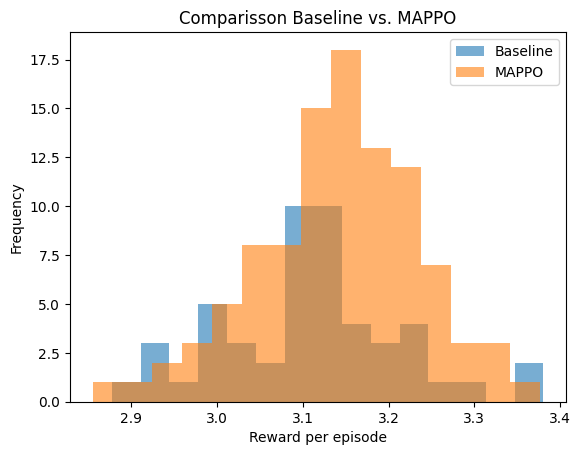

In [32]:
import matplotlib.pyplot as plt

plt.figure()
plt.hist(baseline_rewards, bins=15, alpha=0.6, label="Baseline")
plt.hist(returns_mappo,  bins=15, alpha=0.6, label="MAPPO")
plt.xlabel("Reward per episode")
plt.ylabel("Frequency")
plt.title("Comparisson Baseline vs. MAPPO")
plt.legend()
plt.show()

# Conclusiones

* **Ganancia relativa**: MAPPO obtuvo más recompensa media que la política heurística.
* **Estabilidad**: la desviación estándar disminuyó/aumentó indicando mayor/menor consistencia.
* **Observación**: se aprecia que los agentes aprenden a **reducir frenazos innecesarios** y
  a mantener velocidades cuando el “gap” lo permite.